In [2]:
pip install jupyter_contrib_nbextensions

     ---------------------------------------- 0.0/23.5 MB ? eta -:--:--
     ---------------------------------------- 0.1/23.5 MB 1.6 MB/s eta 0:00:15
     ---------------------------------------- 0.1/23.5 MB 1.7 MB/s eta 0:00:14
     ---------------------------------------- 0.2/23.5 MB 1.7 MB/s eta 0:00:14
     ---------------------------------------- 0.2/23.5 MB 1.7 MB/s eta 0:00:14
      --------------------------------------- 0.3/23.5 MB 1.5 MB/s eta 0:00:16
      --------------------------------------- 0.4/23.5 MB 1.6 MB/s eta 0:00:15
      --------------------------------------- 0.5/23.5 MB 1.5 MB/s eta 0:00:15
      --------------------------------------- 0.5/23.5 MB 1.5 MB/s eta 0:00:15
      --------------------------------------- 0.6/23.5 MB 1.5 MB/s eta 0:00:16
      --------------------------------------- 0.6/23.5 MB 1.5 MB/s eta 0:00:16
      --------------------------------------- 0.6/23.5 MB 1.5 MB/s eta 0:00:16
      --------------------------------------- 0.6/23.5 MB 1

## GPT

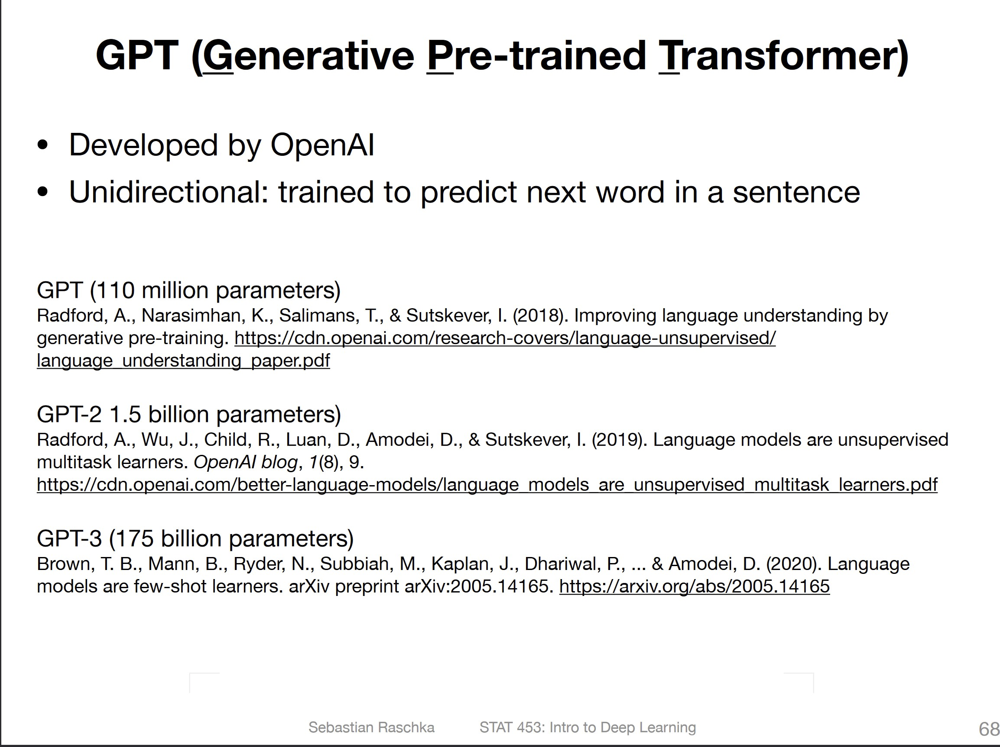

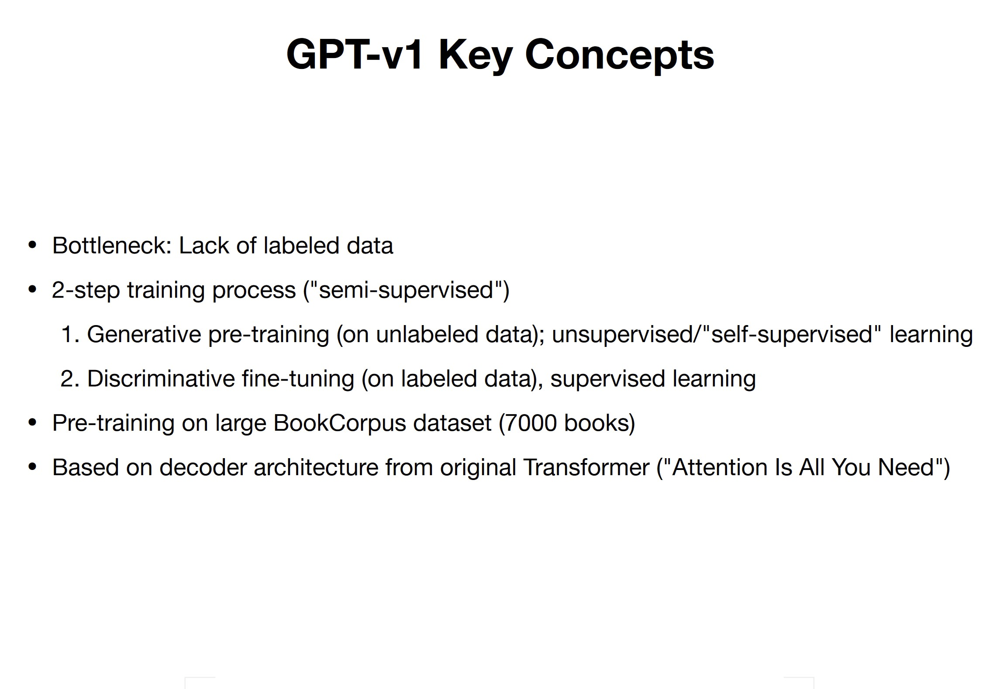

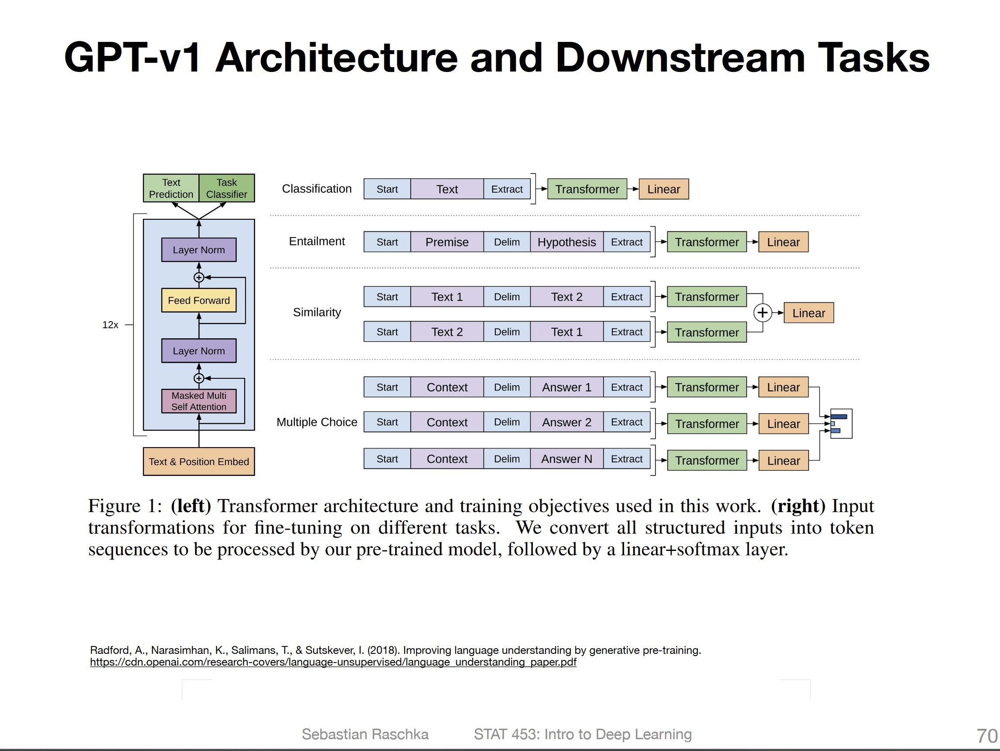

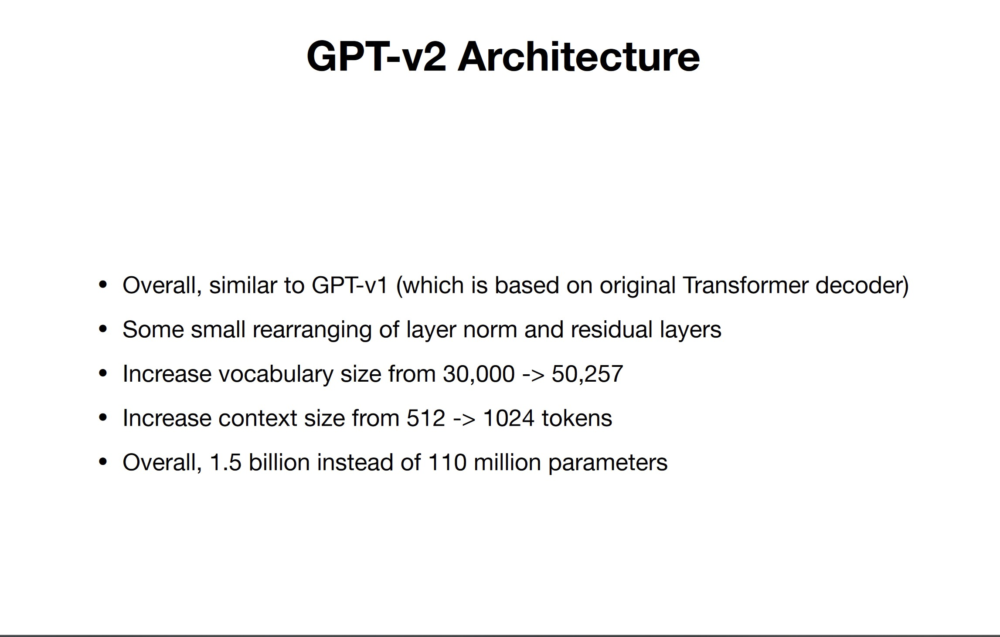

## Language Models are unsupervised multitask learners

 Our largest model, GPT-2,
is a 1.5B parameter Transformer that achieves
state of the art results on 7 out of 8 tested lan-
guage modeling datasets in a zero-shot setting
but still underfits WebText. Samples from the
model reflect these improvements and contain co-
herent paragraphs of text. These findings suggest
a promising path towards building language pro-
cessing systems which learn to perform tasks from
their naturally occurring demonstrations.

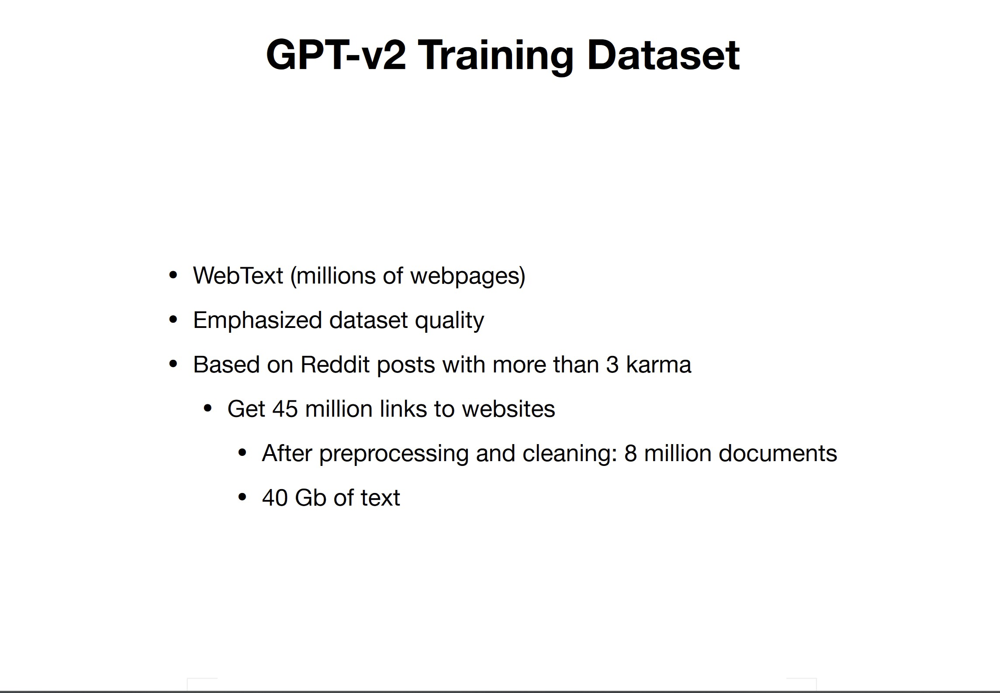

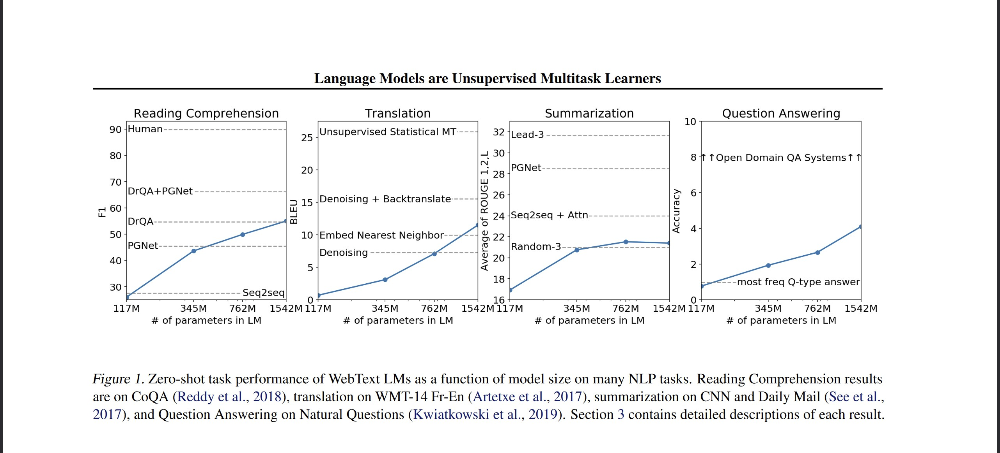

Learning to perform a single task can be expressed in a
probabilistic framework as estimating a conditional distri-
bution p(output|input).

Since a general system should be able to perform many different tasks, even for the same
input, it should condition not only on the input but also
on the task to be performed. That is, it should model
p(output|input, task). This has been variously formalized
in multitask and meta-learning settings. 

Language provides a flexible way to specify tasks, inputs, and outputs all as a
sequence of symbols. For example, a translation training
example can be written as the sequence [FR_TO_EN_TOKEN, english text, french text]. Like-
wise, a reading comprehension training example can
be written as (answer the question, document,
question, answer). 

## Experiments

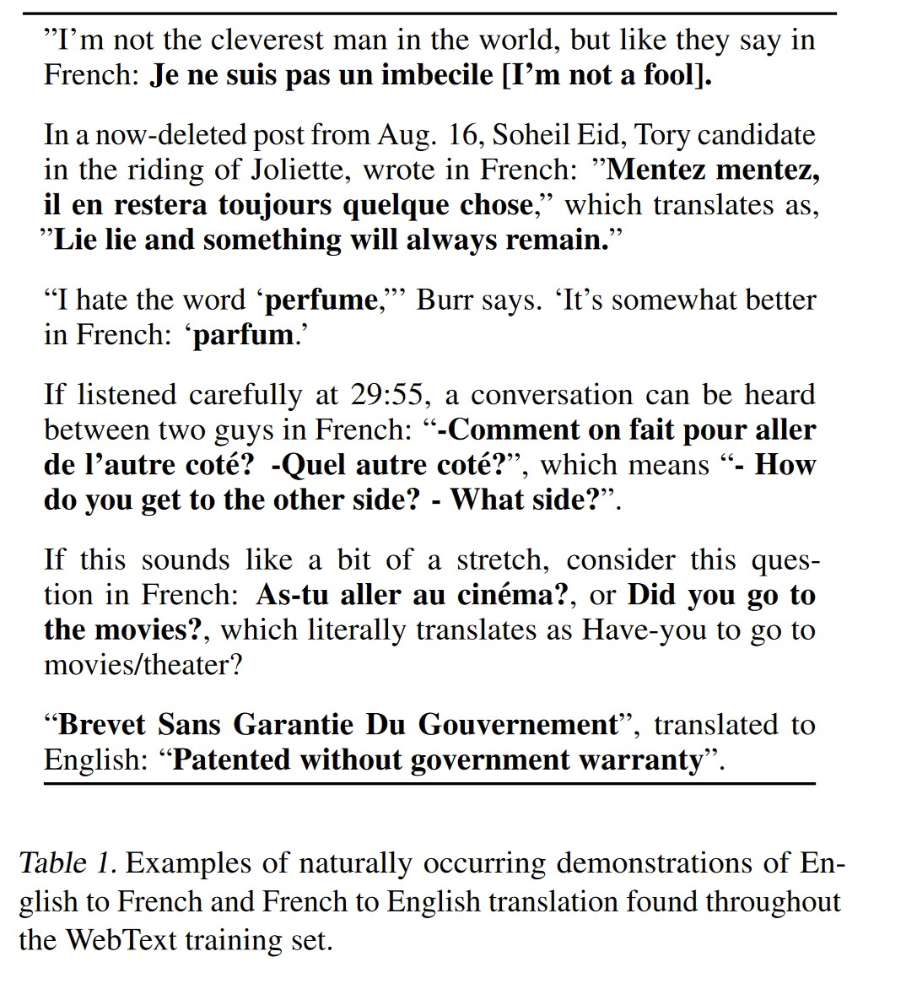

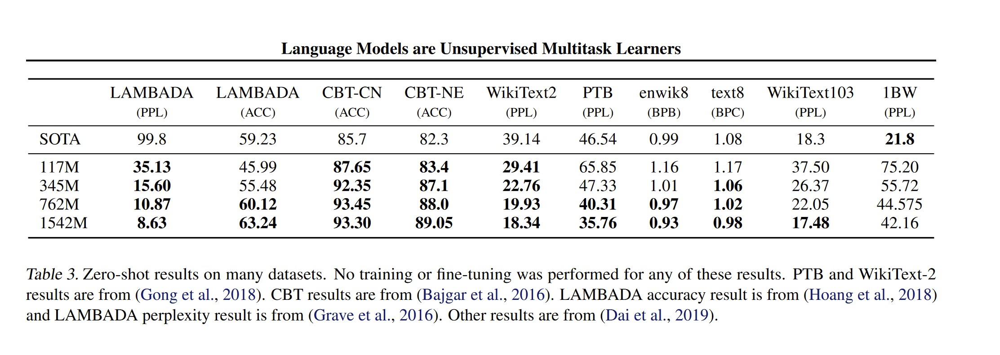

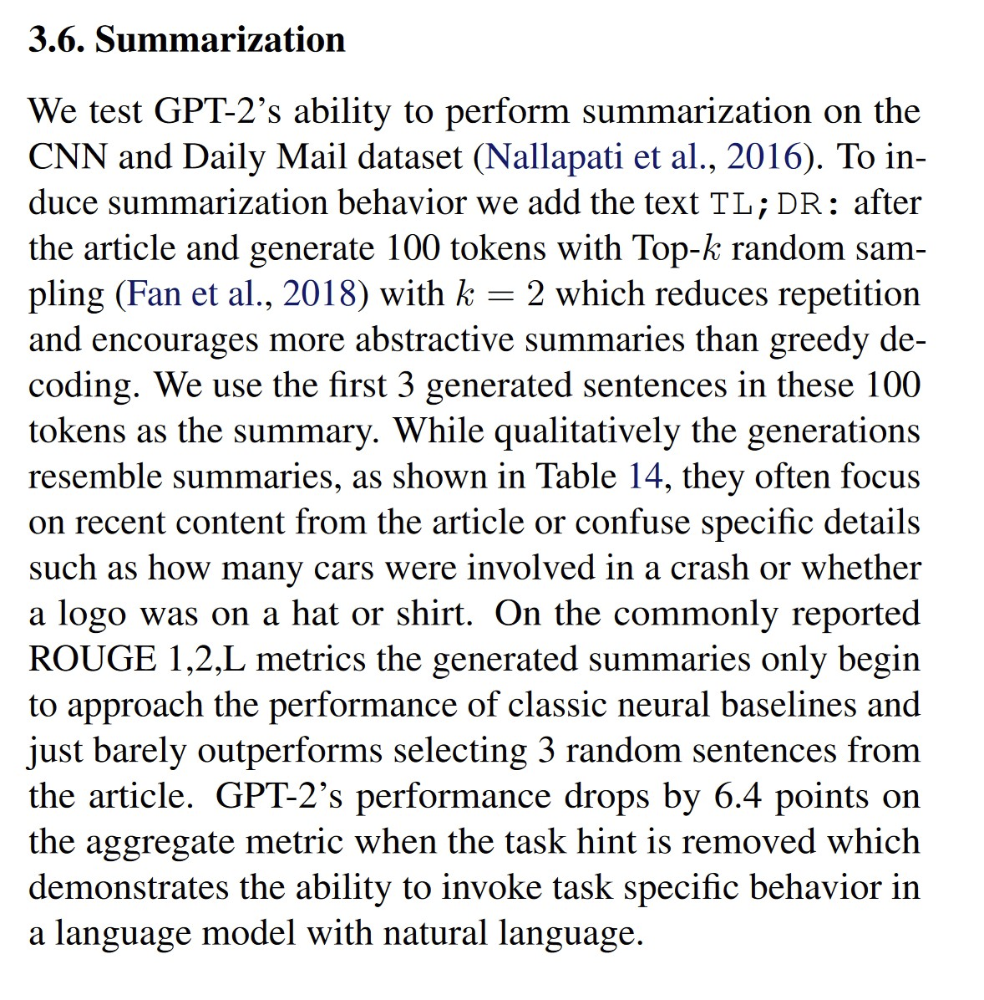

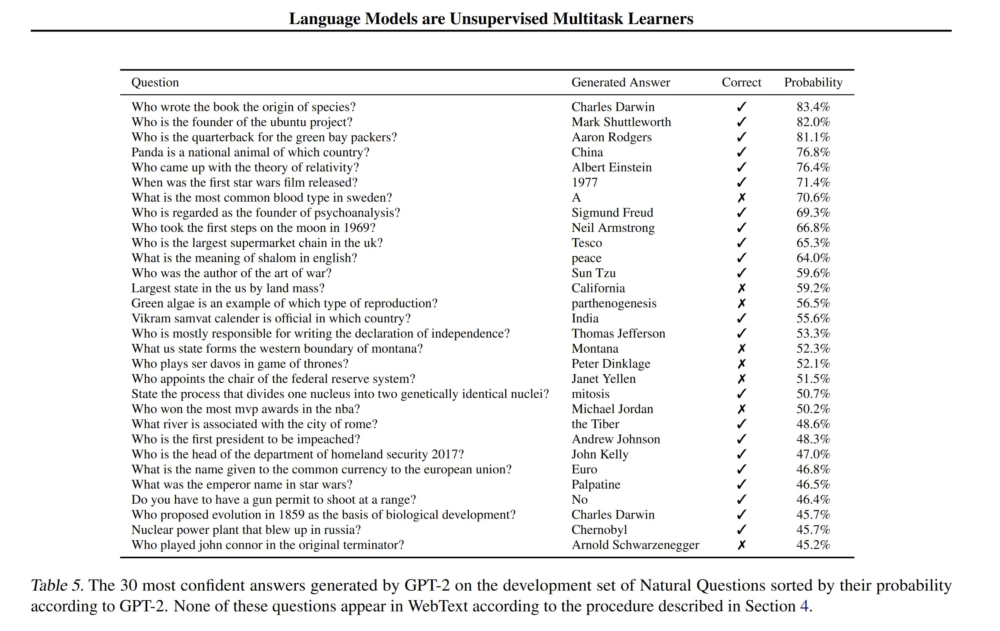

A potential way to test what information is contained within
a language model is to evaluate how often it generates the
correct answer to factoid-style questions. 

## Generalization vs Memorization

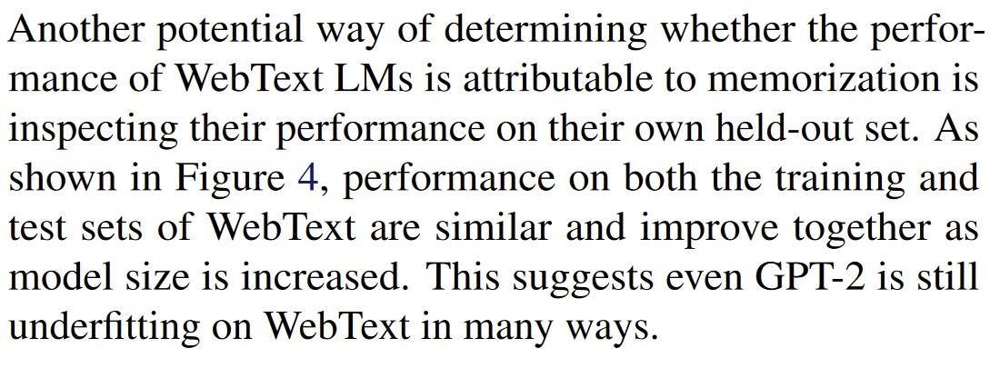

## Implementation

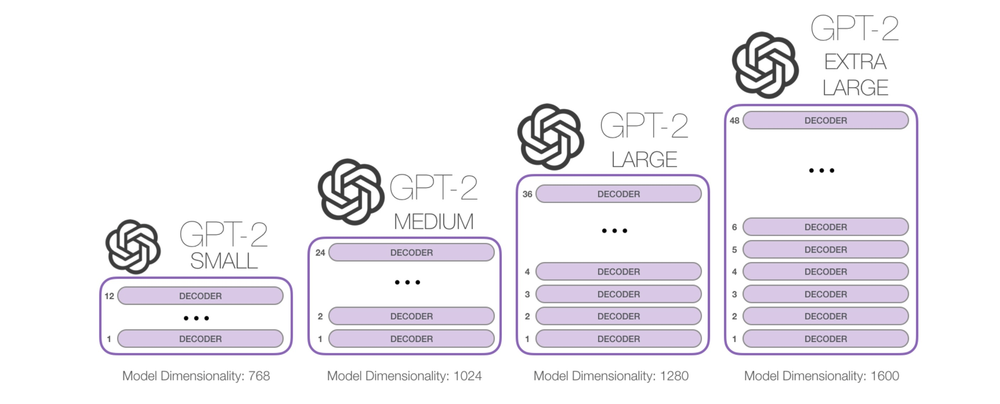

The way these models actually work is that after each token is produced, that token is added to the sequence of inputs. And that new sequence becomes the input to the model in its next step. This is an idea called “auto-regression”

## Decoder Architecture 

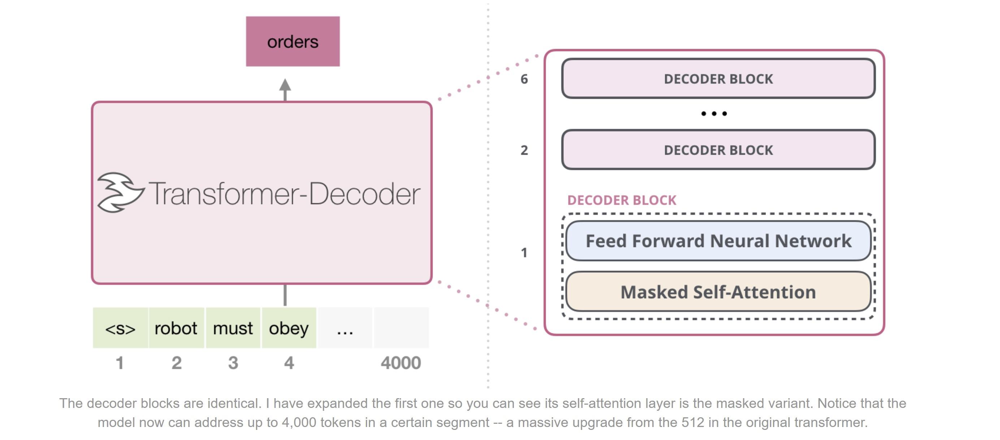

We have a token embedding matrix of dimensions 50000 X  embedding size(768 for small , 1024 medium , 1280 large, 1600 extra large)

Similiarly we have a positional embedding matrix of dimensions 1024(context size) X embedding size 

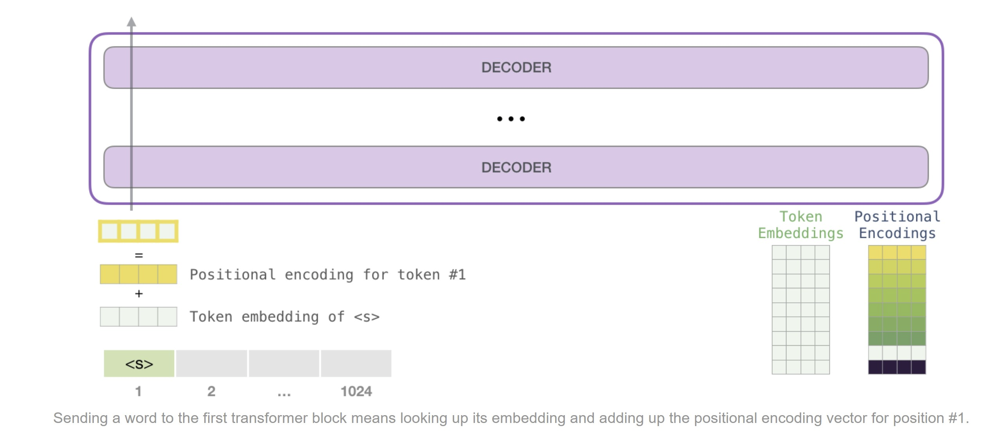

## Self attention

Query: The query is a representation of the current word used to score against all the other words (using their keys). We only care about the query of the token we’re currently processing.

Key: Key vectors are like labels for all the words in the segment. They’re what we match against in our search for relevant words.

Value: Value vectors are actual word representations, once we’ve scored how relevant each word is, these are the values we add up to represent the current word.

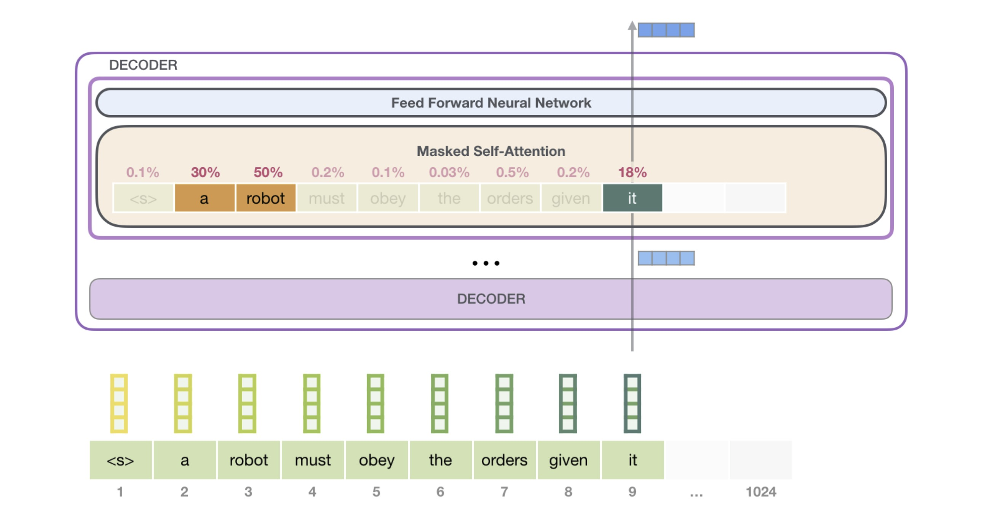

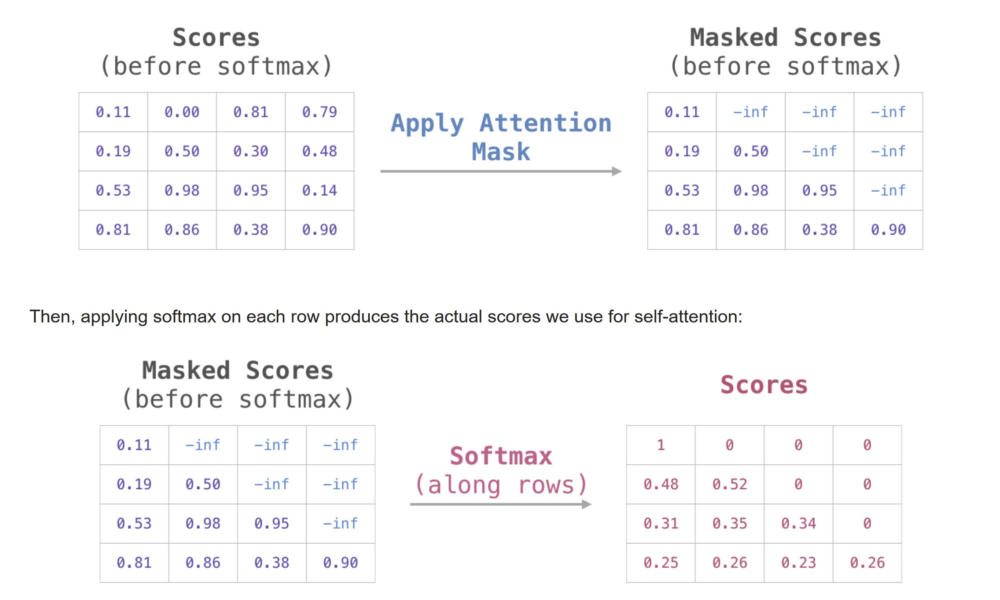

## Model Output

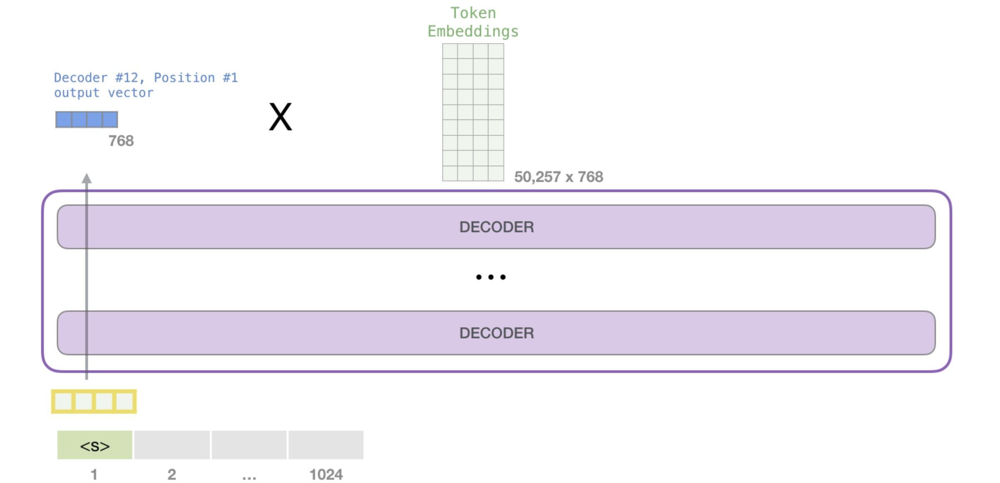

In [14]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

# Hyperparameters
batch_size = 64  # How many independent sequences will we process in parallel?
block_size = 256  # What is the maximum context length for predictions?
max_iters = 5000
eval_interval = 500
learning_rate = 3e-4
device = 'GPU' if tf.test.is_gpu_available() else 'CPU'
eval_iters = 200
n_embd = 384
n_head = 6
n_layer = 6
dropout = 0.2
# ------------

# Set random seed for TensorFlow
tf.random.set_seed(1337)


In [15]:
import tensorflow as tf

# Read the text from 'input.txt'
with open('input.txt', 'r', encoding='utf-8') as f:
    text = f.read()

# Get all unique characters that occur in the text
chars = sorted(list(set(text)))
vocab_size = len(chars)

# Create a mapping from characters to integers
stoi = {ch: i for i, ch in enumerate(chars)}
itos = {i: ch for i, ch in enumerate(chars)}

# Encoder and decoder functions
encode = lambda s: [stoi[c] for c in s]  # Encoder: take a string, output a list of integers
decode = lambda l: ''.join([itos[i] for i in l])  # Decoder: take a list of integers, output a string


In [16]:

# Train and test splits
data = tf.constant(encode(text), dtype=tf.int64)
n = int(0.9 * len(data))  # First 90% will be train, the rest will be validation
train_data = data[:n]
val_data = data[n:]

In [17]:



# Data loading
def get_batch(split):
    # Generate a small batch of data of inputs x and targets y
    data = train_data if split == 'train' else val_data
    ix = tf.random.uniform(shape=(batch_size,), maxval=len(data) - block_size, dtype=tf.int64)
    x = tf.stack([data[i:i+block_size] for i in ix])
    y = tf.stack([data[i+1:i+block_size+1] for i in ix])
    x, y = x.numpy(), y.numpy()  # Convert tensors to NumPy arrays
    return x, y

@tf.function
def estimate_loss():
    out = {}
    model.trainable = False  # Set model to evaluation mode
    for split in ['train', 'val']:
        losses = tf.TensorArray(dtype=tf.float32, size=eval_iters)
        for k in range(eval_iters):
            X, Y = get_batch(split)
            logits, loss = model(X, Y)
            losses = losses.write(k, loss)
        out[split] = tf.reduce_mean(losses.stack()).numpy()
    model.trainable = True  # Set model back to training mode
    return out


In [18]:
class Head(keras.layers.Layer):
    """ One head of self-attention """

    def __init__(self, head_size):
        super(Head, self).__init__()
        self.key = keras.layers.Dense(units=head_size, use_bias=False)
        self.query = keras.layers.Dense(units=head_size, use_bias=False)
        self.value = keras.layers.Dense(units=head_size, use_bias=False)
        self.dropout = keras.layers.Dropout(rate=dropout)

    def call(self, x):
        # Input of shape (batch, time-step, channels)
        # Output of shape (batch, time-step, head size)
        B, T, C = tf.shape(x)
        k = self.key(x)  # (B, T, hs)
        q = self.query(x)  # (B, T, hs)

        # Compute attention scores ("affinities")
        wei = tf.matmul(q, tf.transpose(k, perm=[0, 2, 1])) * tf.math.sqrt(1.0 / k.shape[-1])  # (B, T, T)

        # Mask the upper triangular part
        mask = tf.linalg.band_part(tf.ones((T, T), dtype=tf.float32), -1, 0)
        wei = tf.where(mask == 0, float('-inf'), wei)  # (B, T, T)

        wei = tf.nn.softmax(wei, axis=-1)  # (B, T, T)
        wei = self.dropout(wei)

        # Perform the weighted aggregation of the values
        v = self.value(x)  # (B, T, hs)
        out = tf.matmul(wei, v)  # (B, T, T) @ (B, T, hs) -> (B, T, hs)
        return out


In [19]:
class MultiHeadAttention(keras.layers.Layer):
    """ Multiple heads of self-attention in parallel """

    def __init__(self, num_heads, head_size):
        super(MultiHeadAttention, self).__init__()
        self.heads = [Head(head_size) for _ in range(num_heads)]
        self.proj = keras.layers.Dense(units=n_embd)
        self.dropout = keras.layers.Dropout(rate=dropout)

    def call(self, x):
        out = tf.concat([h(x) for h in self.heads], axis=-1)
        out = self.dropout(self.proj(out))
        return out

class FeedForward(keras.layers.Layer):
    """ A simple linear layer followed by a non-linearity """

    def __init__(self, n_embd):
        super(FeedForward, self).__init__()
        self.net = keras.Sequential([
            keras.layers.Dense(units=4 * n_embd),
            keras.layers.ReLU(),
            keras.layers.Dense(units=n_embd),
            keras.layers.Dropout(rate=dropout),
        ])

    def call(self, x):
        return self.net(x)

class Block(keras.layers.Layer):
    """ Encoder block: communication followed by computation """

    def __init__(self, n_embd, n_head):
        # n_embd: embedding dimension, n_head: the number of heads we'd like
        super(Block, self).__init__()
        head_size = n_embd // n_head
        self.sa = MultiHeadAttention(n_head, head_size)
        self.ffwd = FeedForward(n_embd)
        self.ln1 = keras.layers.LayerNormalization(epsilon=1e-6)
        self.ln2 = keras.layers.LayerNormalization(epsilon=1e-6)

    def call(self, x):
        x_sa = self.sa(x)  # Self-attention
        x = x + x_sa  # Residual connection
        x = self.ln1(x)  # Layer normalization

        x_ffwd = self.ffwd(x)  # Feed-forward
        x = x + x_ffwd  # Residual connection
        x = self.ln2(x)  # Layer normalization

        return x



In [22]:
class GPTLanguageModel(keras.Model):

    def __init__(self):
        super(GPTLanguageModel, self).__init__()
        # Specify input_shape for layers
        self.token_embedding_table = keras.layers.Embedding(input_dim=vocab_size, output_dim=n_embd, input_shape=(None, block_size), embeddings_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02))
        self.position_embedding_table = keras.layers.Embedding(input_dim=block_size, output_dim=n_embd, input_shape=(None, block_size), embeddings_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02))
        self.blocks = keras.Sequential([Block(n_embd, n_head=n_head) for _ in range(n_layer)])
        self.ln_f = keras.layers.LayerNormalization(epsilon=1e-6)
        self.lm_head = keras.layers.Dense(units=vocab_size, use_bias=False, kernel_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02))

    def call(self, idx, targets=None):
        B, T = idx.shape

        # idx and targets are both (B, T) tensors of integers
        tok_emb = self.token_embedding_table(idx)  # (B, T, C)
        pos_emb = self.position_embedding_table(tf.range(T, dtype=tf.int64))  # (T, C)
        x = tok_emb + pos_emb  # (B, T, C)
        x = self.blocks(x)  # (B, T, C)
        x = self.ln_f(x)  # (B, T, C)
        logits = self.lm_head(x)  # (B, T, vocab_size)

        if targets is None:
            loss = None
        else:
            B, T, C = logits.shape
            logits = tf.reshape(logits, (B * T, C))
            targets = tf.reshape(targets, (B * T,))
            loss = tf.reduce_mean(tf.keras.losses.sparse_categorical_crossentropy(targets, logits, from_logits=True))

        return logits, loss

    def generate(self, idx, max_new_tokens):
        # idx is (B, T) array of indices in the current context
        for _ in range(max_new_tokens):
            # Crop idx to the last block_size tokens
            idx_cond = idx[:, -block_size:]
            # Get the predictions
            logits, _ = self(idx_cond)
            # Focus only on the last time step
            logits = logits[:, -1, :]  # Becomes (B, C)
            # Apply softmax to get probabilities
            probs = tf.nn.softmax(logits, axis=-1)  # (B, C)
            # Sample from the distribution
            idx_next = tf.random.categorical(probs, num_samples=1, dtype=tf.int64)  # (B, 1)
            # Append sampled index to the running sequence
            idx = tf.concat((idx, idx_next), axis=1)  # (B, T+1)
        return idx


In [24]:
import numpy as np

# Create a dummy input tensor with the correct data type and shape
dummy_input = tf.zeros((batch_size, block_size), dtype=tf.int64)

# Instantiate the model
model = GPTLanguageModel()

# Call the model on the dummy input to build the layers
_ = model(dummy_input)

_

(<tf.Tensor: shape=(64, 256, 65), dtype=float32, numpy=
 array([[[ 0.52696633, -0.5108967 , -0.0914256 , ...,  0.62806195,
           0.28485382,  0.10968249],
         [ 0.49652693, -0.5506526 , -0.03054007, ...,  0.6090574 ,
           0.22837062,  0.02659578],
         [ 0.52372766, -0.6079502 , -0.00253238, ...,  0.6202132 ,
           0.20316483, -0.02308761],
         ...,
         [ 0.17400506, -0.25402442, -0.13408317, ...,  0.41702175,
           0.08499949,  0.0868462 ],
         [ 0.23396772, -0.25633493, -0.13301528, ...,  0.45125255,
           0.1253759 ,  0.09650268],
         [ 0.20595728, -0.27403563, -0.10712727, ...,  0.43713826,
           0.13962527,  0.10597876]],
 
        [[ 0.52696633, -0.5108967 , -0.0914256 , ...,  0.62806195,
           0.28485382,  0.10968249],
         [ 0.49652693, -0.5506526 , -0.03054007, ...,  0.6090574 ,
           0.22837062,  0.02659578],
         [ 0.52372766, -0.6079502 , -0.00253238, ...,  0.6202132 ,
           0.20316483, -0.02

In [ ]:
# Print the number of parameters in the model
num_params = sum(np.prod(w.shape) for w in model.trainable_variables) / 1e6
print(f"{num_params:.2f} M parameters")

# The rest of your training and generation code remains the same



model.build((batch_size, block_size))  # Build the model with specific input shape
# Print the number of parameters in the model
num_params = sum(np.prod(w.shape) for w in model.trainable_variables) / 1e6
print(f"{num_params:.2f} M parameters")

# Create a TensorFlow optimizer
optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)

for iter in range(max_iters):

    # Every once in a while, evaluate the loss on train and val sets
    if iter % eval_interval == 0 or iter == max_iters - 1:
        losses = estimate_loss()
        print(f"step {iter}: train loss {losses['train']:.4f}, val loss {losses['val']:.4f}")

    # Sample a batch of data
    xb, yb = get_batch('train')

    # Evaluate the loss
    with tf.GradientTape() as tape:
        logits, loss = model(xb, yb)

    grads = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(grads, model.trainable_variables))

# Generate from the model
context = tf.zeros((1, 1), dtype=tf.int64)
generated_sequence = model.generate(context, max_new_tokens=500).numpy()[0]
print(decode(generated_sequence.tolist()))
